# Introduction

The primary motivation behind this project is to investigate the feasibility of predicting dog emotions from pictures using machine learning. Understanding dog emotions is challenging with current technology, and this project aims to determine whether advanced machine learning algorithms can create a reliable tool for this purpose.

Pet owners are the main target audience for this tool, as it will help them better understand their dog's emotional states and perhaps use it for recreational activities. If the model achieves high accuracy, it could also benefit future research projects or help dog trainers develop more effective training techniques.

The successful implementation of this model will provide pet owners with a better understanding of dog emotions, potentially leading to deeper relationships with their pets. Furthermore, it might provide insightful information to experts and researchers studying animal behaviour.

## Contents

- [Data Sourcing](#data-sourcing)

- [Data Requirements](#data-requirements)
    - [Required Data Elements](#required-data-elements)
    - [Identify and List Data Elements](#list-data-elements)
    - [Data Volume](#data-volume)
    - [Data Quality Standards](#data-quality)
    - [Ethical and Legal Aspects](#ethical-and-legal-aspects)

- [Imports](#imports)

- [Data Collection](#data-collection)
    - [Sample Images](#sampling)

- [Data Understanding](#data-understanding)
    
- [Data Preparation](#data-preparation)
    - [Checking for Missing Values](#checking-for-missing-values)
    - [Handling Duplicates](#handling-duplicates)
    - [Ensuring Data Integrity](#data-integrity)
        - [Object Detection Using YOLOv3](#object-detection)
    - [Loading the cleaned data](#loading-clean-data)

- [Preprocessing](#preprocessing)
    - [Splitting into Train/Test/Validation](#splitting)

- [Baseline CNN](#baseline-cnn)
    - [Modelling](#modelling-baseline-cnn)
    - [Evaluation](#evaluation-baseline-cnn)
    - [Conclusion](#conclusion-baseline-cnn)


- [CNN with Data Augmentation](#cnn-with-data-augmentation)
    - [Data Augmentation](#data-augmentation-cnn-with-data-augmentation)
    - [Modelling](#modelling-data-augmentation-cnn)
    - [Evaluation](#evaluation-data-augmentation-cnn)
    - [Conclusion](#conclusion-data-augmentation-cnn)

- [CNN with VGG16 Convolutional Base](#cnn-vgg16-base)
    - [Data Augmentation](#data-augmentation-cnn-vgg16-base)
    - [Modelling](#modelling-cnn-vgg16-base)
    - [Evaluation](#evaluation-cnn-vgg16-base)
    - [Conclusion](#conclusion-cnn-vgg16-base)

- [Refined Data Preparation](#refined-data-preparation)
    - [Object Detection and Dog Face Extraction using YOLOv3](#dog-face-extraction)
    - [Oversampling](#oversampling)
    - [Loading the refined data](#loading-the-refined-data)

- [MobileNet](#mobilenet)
    - [Data Augmentation](#data-augmentation-mobilenet)
    - [Modelling](#modelling-mobilenet)
    - [Evaluation](#evaluation-mobilenet)
    - [Conclusion](#conclusion-mobilenet)

- [MobileNet with Fine-Tuning](#mobilenet-mobilenet-fine-tune)
    - [Data Augmentation](#data-augmentation-mobilenet-fine-tune)
    - [Modelling](#modelling-mobilenet-fine-tune)
    - [Evaluation](#evaluation-mobilenet-fine-tune)
    - [Conclusion](#conclusion-mobilenet-fine-tune)

- [References](#references)


# Data Sourcing <a class="anchor" id="data-sourcing"></a>

In this project, a balanced method was employed to source the dataset, aiming for an optimal number of images. An insufficient number of images might not provide enough data to train a reliable model, while an extensively large dataset could significantly increase computational time. Achieving this balance ensures the model is trained effectively without sacrificing performance or efficiency during training and prediction phases.

Despite the numerous sources available, many either had too many samples, which would extend computation time significantly, or included images of animals other than dogs. Therefore, the best option was chosen.

The chosen dataset [(Dog Emotion, 2023)](#references) is available on Kaggle. This dataset contains folders of dog images categorized into four groups: 'happy', 'angry', 'sad', and 'relaxed'. This classification enables focused training and evaluation of the machine learning model on distinct emotional states commonly observed in dogs. This dataset meets the project's requirements and provides the necessary information for training the predictive model.

The dataset source does not offer updates, so version control actions will not be necessary for managing changes or updates in the data throughout the project.

If the dataset were to be updated, an effective version control strategy would involve creating a Python script using Kaggle's API. This script would regularly compare metadata, such as last modified dates or version numbers, to identify updates. Upon detecting a new version, the script would automatically download the updated dataset to a predetermined location. Version numbers could be added to the dataset file name for version control. The script could be scheduled to run automatically at specified times using task scheduling software, eliminating the need for manual supervision.

# Data Requirements <a class="anchor" id="data-requirements"></a>

## Required Data Elements <a class="anchor" id="required-data-elements"></a>

The starting point for this project involves defining the target variable and understanding its categories. In this project, the target variable is `label`, which is a categorical variable with the following classes: `happy`, `angry`, `sad`, and `relaxed`. The goal is to predict these emotional states from images of dogs.

The features used to predict the `label` are the RGB values for each pixel in the images. These pixel values form the basis for the machine learning model to learn and make predictions. Given the categorical nature of the target variable, this project is a classification problem.

Understanding these elements is crucial for selecting appropriate machine learning algorithms and evaluation metrics to ensure accurate and reliable predictions of dog emotions.

## Identify and List Data Elements <a class="anchor" id="list-data-elements"></a>

The source provides the images organized in folders named according to the labels. After reading these images into a DataFrame, the resulting columns are:

(1) `label` (object): Emotional state of the dog (happy, angry, sad, relaxed)

(2) `image` (object): Array of RGB pixel values for each image

## Data Volume <a class="anchor" id="data-volume"></a>

The dataset consists of 2 columns and 4000 dog samples. While the dataset is not large in terms of columns, it contains a decent number of samples for training a machine learning model. Throughout the project, some data preparation steps will be required, such as handling duplicates or ensuring data quality, which could affect the final number of samples available for modeling.

For model training and evaluation, the data will be split into training, validation, and test sets. Initially, the dataset will be divided into training and testing sets using an 80%/20% split. Subsequently, the training set will be further split into training and validation sets using a 75%/25% split. These proportions ensure sufficient data for training, validation, and testing while maintaining consistency in model evaluation.

## Data Quality Standards <a class="anchor" id="data-quality"></a>

The data for this project must meet specific standards before it can be used to train the model. This includes ensuring completeness, accuracy, and suitability for machine learning tasks. Several steps will be taken to achieve these standards including checking for missing values, handling duplicates, ensuring data integrity and others.

Data integrity for the image data involves several criteria:

- **Presence of a Dog**: Images must clearly feature a dog to be included in the dataset.
- **Visibility of Dog Faces**: The dog's face should be sufficiently visible and identifiable in the image.
- **Exclusion of People**: Images where people are present, without a clear focus on the dog, are excluded to maintain dataset purity.

The exclusion of people from the dataset was based on domain understanding that reveals how dogs are sensitive to and influenced by human emotions and interactions. Research indicates that dogs perceive and react to various cues from humans, including body language, scent, and emotional tones. For instance, oxytocin released during interactions like petting helps dogs recognize and respond to human emotions. Dogs also exhibit empathy by mirroring the emotions of people important to them. [(Colino, 2021)](#references)

This sensitivity highlights the potential for human presence in images to influence dog emotions, introducing bias into the dataset. To ensure the dataset's integrity and purity, images should focus exclusively on clear representations of dogs and their emotional expressions, without human interference in order to mitigate any bias.

## Ethical and Legal Aspects <a class="anchor" id="ethical-and-legal-aspects"></a>

The dataset used in this project has been sourced from Kaggle and the creator specifies that he manually annotated the images after collecting them from various online sources.

# Imports <a class="anchor" id="imports"></a>

In [1]:
import os
import copy
import math
import random
import hashlib

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import cv2
import PIL.Image as Image

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16, MobileNet
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder


from sklearnex import patch_sklearn
patch_sklearn()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


# Data Collection <a class="anchor" id="data-collection"></a>

The function `load_images_from_folder` is designed to read images from a specified folder and organize them into a DataFrame. It takes each image, adjusts its size to 224x224 pixels for consistency and assigns the folder's name as the label for each image.

In [2]:
def load_images_from_folder(folder):
    images = []
    labels = []
    for subdir, _, files in os.walk(folder):
        for file in files:
            if file.endswith(('png', 'jpg', 'jpeg')):
                img_path = os.path.join(subdir, file)
                try:
                    img = Image.open(img_path)
                    img = img.resize((224, 224))
                    img_array = np.array(img)
                    images.append(img_array)
                    
                    label = os.path.basename(subdir)
                    labels.append(label)
                except Exception as e:
                    print(f"Error loading image {img_path}: {e}")
    
    return pd.DataFrame({'image': images, 'label': labels})

In [3]:
dog_emotions = load_images_from_folder('dog_emotions')

The `plot_sample_images` function is designed to display a sample of images in a grid format for visual inspection. This function is useful for quickly visualizing a subset of images from a dataset which would be helpful in data exploration and understanding.

In [4]:
def plot_sample_images(images, sample_size=24, title=None, random=True):

    plotimgs = copy.deepcopy(images)

    if random:
        np.random.shuffle(plotimgs)
    
    rows = plotimgs[:sample_size]
    
    nrows = math.ceil(sample_size / 8)
    
    _, subplots = plt.subplots(nrows=nrows, ncols=8, figsize=(18, int(sample_size / 3)))
    subplots = subplots.flatten()
    
    for i, img in enumerate(rows):
        subplots[i].imshow(img)
        subplots[i].set_xticks([])
        subplots[i].set_yticks([])
    
    for j in range(i + 1, len(subplots)):
        subplots[j].axis('off')

    if title:
        plt.suptitle(title, fontsize=12)
    
    plt.show()

## Sample Images <a class="anchor" id="sampling"></a>

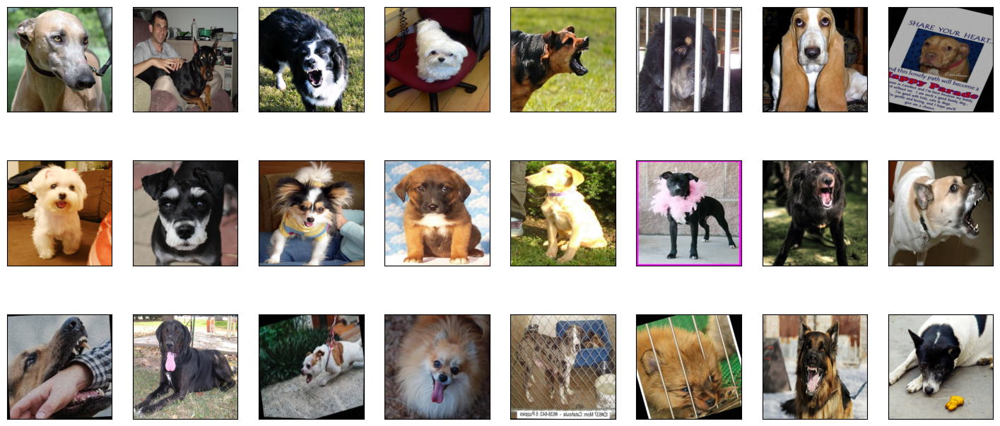

In [5]:
plot_sample_images(dog_emotions['image'].values, sample_size=24)

# Data Understanding <a class="anchor" id="data-understanding"></a>

The unique labels in the dataset are examined at the beginning of the data understanding phase.

This initial verification confirms that all expected labels are present in the dataset and ensures that there are no unexpected ones which guarantees data consistency before further analysis or modeling.

In [6]:
dog_emotions['label'].unique()

array(['angry', 'happy', 'relaxed', 'sad'], dtype=object)

In order to make manual label inspection and validation simpler, sample images from each label are being visualized. This process includes conducting a label consistency check to ensure that images sampled under the same label consistently exhibit similar visual cues or patterns that align with common interpretations of dog emotions.

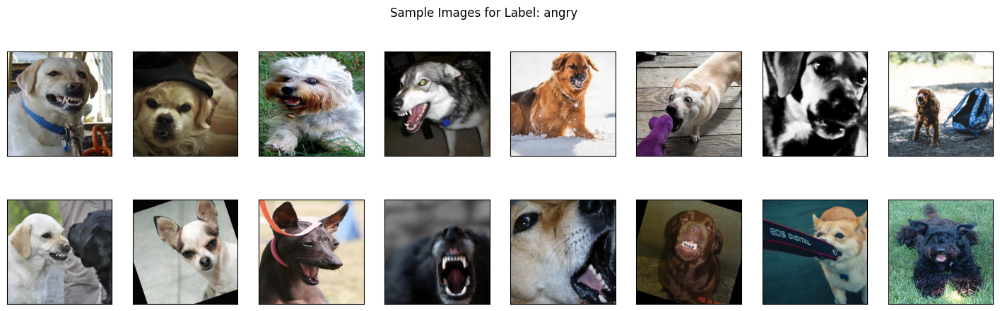

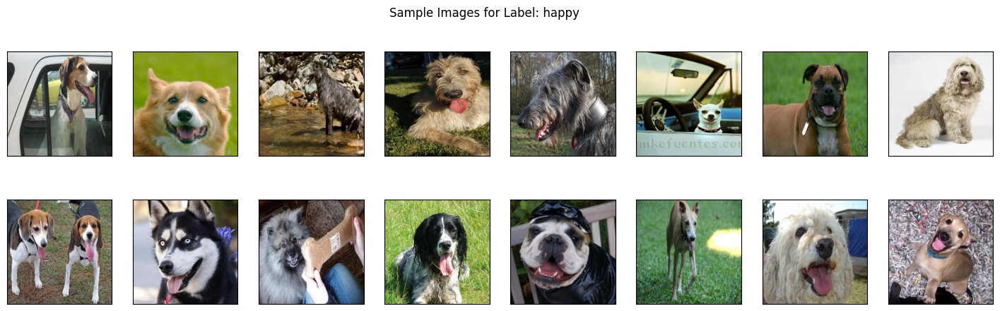

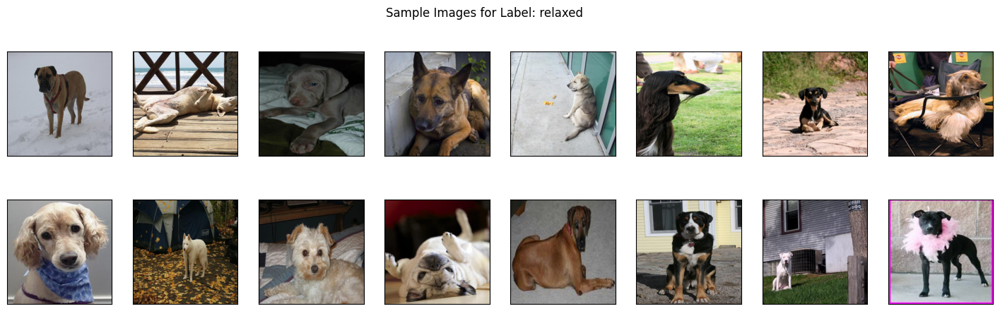

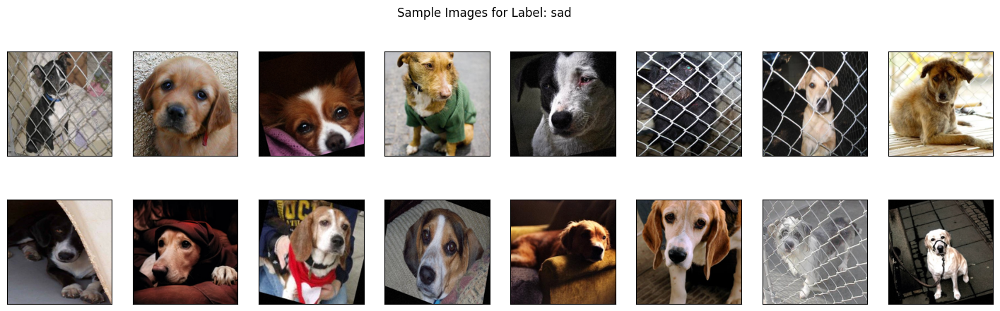

In [7]:
labels = dog_emotions['label'].unique()

for label in labels:
    label_images = dog_emotions.loc[dog_emotions['label'] == label, 'image'].values
    plot_sample_images(label_images, 16, f'Sample Images for Label: {label}')

Upon manual inspection, most of the images appear to match their labels with a small margin of error. It is noticeable in some samples that the visual cues of the dogs do not consistently align with others under the same label. However, given the small margin of error, the data could be considered as decently labeled at this stage of the project.

The distribution of labels will be examined next.

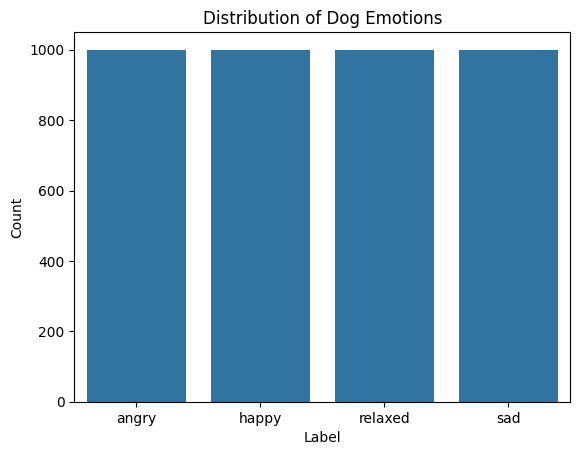

In [8]:
sns.countplot(x='label', data=dog_emotions)

plt.title('Distribution of Dog Emotions')
plt.xlabel('Label')
plt.ylabel('Count')

plt.show()

The visualization of the label distribution shows that there are equal numbers of samples for the `happy`, `relaxed`, `sad`, and `angry` categories, with each label having 1000 samples. This balanced sample distribution is beneficial since it ensures that the model has an equal opportunity to learn from each emotion category, leading to more reliable and unbiased predictions across all labels.

In [9]:
image_stats = dog_emotions['image'].apply(lambda img: (np.mean(img), np.std(img)))
image_stats_df = pd.DataFrame(image_stats.tolist(), columns=['mean', 'std'])
image_stats_df.describe()

,mean,std
count,4000.000000,4000.000000
mean,110.484959,59.947891
std,29.750918,13.127481
min,7.460466,17.551924
25%,91.311399,51.096009
50%,110.422868,59.561382
75%,129.161022,68.293506
max,227.147089,106.121553


Inspecting the image statistics allows for the assessment of the range and variability of pixel intensities across the images. Considering the wide range of pixel intensities, normalization techniques could be applied in later stages in order to ensure that all images contribute equally to the learning process which would be beneficial in optimizing the model performance and accuracy.

# Data Preparation <a class="anchor" id="data-preparation"></a>

## Checking for Missing Values <a class="anchor" id="checking-for-missing-values"></a>

In [10]:
dog_emotions.isnull().sum()

image    0
label    0
dtype: int64

The output indicates that there are no missing values in either the `image` or `label` columns.

## Handling Duplicates <a class="anchor" id="handling-duplicates"></a>

The function `compute_image_hash` generates a hash for each image in the dataset using the MD5 hashing algorithm.

The reason for creating a hash of each image is to make the comparison and identification of duplicate images more efficient since directly comparing pixel values of images would be computationally expensive and time-consuming.

In [11]:
def compute_image_hash(image_data):
    return hashlib.md5(image_data.tobytes()).hexdigest()

dog_emotions['image_hash'] = dog_emotions['image'].apply(lambda x: compute_image_hash(x))

In [12]:
duplicate_images = dog_emotions[dog_emotions.duplicated(subset=['image_hash'], keep=False)]

if duplicate_images.empty:
    print("No duplicate images found")
else:
    duplicate_counts = len(duplicate_images.groupby('image_hash').size().reset_index(name='duplicate_count'))
    
    print(f'Duplicate images found: {duplicate_counts}')

Duplicate images found: 4


It is evident that there are 4 duplicate images identified. Before removing them from the dataset, the duplicated pairs will be visualized in order to verify their duplication.

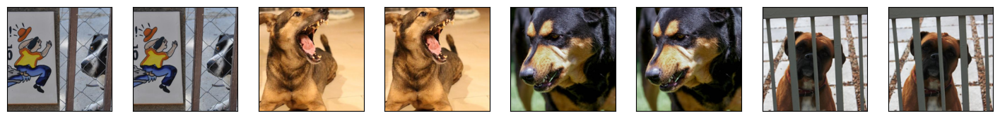

In [13]:
duplicate_images = duplicate_images.sort_values(by='image_hash')

plot_sample_images(duplicate_images['image'].values, 8, random=False)

Since the visualizations confirm that the images are indeed duplicated, it is safe to proceed with their removal from the dataset.

In [14]:
dog_emotions = dog_emotions.drop_duplicates(subset=['image_hash'])

In [15]:
dog_emotions.drop(columns=['image_hash'], inplace=True)

In [16]:
dog_emotions.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3996 entries, 0 to 3999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   3996 non-null   object
 1   label   3996 non-null   object
dtypes: object(2)
memory usage: 93.7+ KB


## Ensuring Data Integrity <a class="anchor" id="data-integrity"></a>

Since manual inspection of all images would be time-consuming, it is important to implement an approach to ensure the dataset contains only images of dogs and excludes any that may include people or other animals. This is essential to prevent potential bias in the dataset.

Therefore, in order to maintain data integrity and adhere to the project's initial standards - ensuring the presence of a dog, visibility of dog faces, and the exclusion of people - a data cleaning process is required. This process will involve filtering out images that do not meet these criteria, thereby refining the dataset to ensure it accurately represents the intended scope of the project.

### Object Detection Using YOLOv3 <a class="anchor" id="object-detection"></a>

The pre-trained YOLOv3 model will be used for object detection as part of the dataset cleaning process. YOLOv3 is a deep learning model known for its efficiency and accuracy in real-time object detection tasks. Employing this pre-trained model will assist in the identification and removal of images from the dataset that do not meet the project's defined standards, such as those with no dog presence, unclear visibility of dog faces, or containing people.

In [17]:
dog_emotions.insert(0, 'id', range(1, len(dog_emotions) + 1))

The code below loads the model and reads a file that contains a list of class names from the COCO (Common Objects in Context) dataset. These names correspond to the class IDs utilized by the YOLOv3 model.

In [18]:
net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
classes = []
with open("coco.names", "r") as f:
    classes = [line.strip() for line in f.readlines()]

The function `contains_dog` performs the dog detection in an image. It normalizes the input image, prepares it for processing and sets the input to the neural network. It then iterates through the detections to determine if a dog (class ID 16 in the COCO dataset) is present based on confidence scores, while also checking for people (class ID 0 in the COCO dataset). Finally, the function returns `True` if only a dog is detected and `False` otherwise.

In [19]:
def contains_dog(image, confidence_threshold=0.5):
    blob = cv2.dnn.blobFromImage(image, 1/255.0, (416, 416), swapRB=True, crop=False)

    net.setInput(blob)
    outs = net.forward(net.getUnconnectedOutLayersNames())

    has_dog = False

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            if confidence > confidence_threshold:
                if class_id == 16:
                    has_dog = True
                elif class_id == 0:
                    return False
    
    return has_dog

The function for dog detection is tested on a random sample from the dataset, and it shows that it performs reliably.

This is a picture of a dog: True


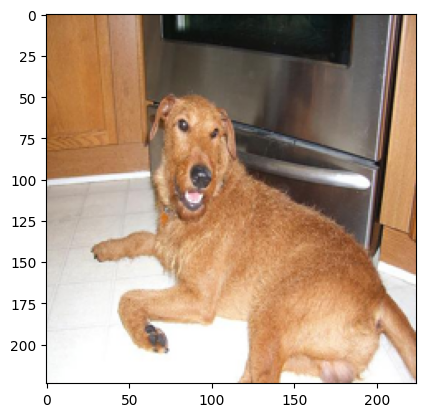

In [20]:
sample_image = dog_emotions.sample()['image'].iloc[0]

is_dog = contains_dog(sample_image)

print(f'This is a picture of a dog: {is_dog}')
plt.imshow(sample_image)
plt.show()

The function `clean_dataframe` filters out images where the `contains_dog` function detects a dog and then it returns a new DataFrame containing only the images where a dog was identified.

In [21]:
def clean_dataframe(df, confidence_threshold=0.4):
    cleaned_images_ids = []

    for _, row in df.iterrows():
        image_data = row['image']
        image_id = row['id']
        if contains_dog(image_data, confidence_threshold):
            cleaned_images_ids.append(image_id)

    cleaned_df = df[df['id'].isin(cleaned_images_ids)]

    return cleaned_df

In [22]:
dog_emotions_cleaned = clean_dataframe(dog_emotions)

In [23]:
removed_images = dog_emotions[~dog_emotions['id'].isin(dog_emotions_cleaned['id'])]

The cleaned images will be saved into a new folder structure where each label corresponds to a separate folder, and the removed images will be stored separately for futher inspection.

In [24]:
def save_as_jpeg(image, output_folder, image_name):
    image_array = np.array(image, dtype=np.uint8)
    image = Image.fromarray(image_array)
    image.save(os.path.join(output_folder, f"{image_name}.jpeg"))

def save_images_by_label(df, parent_output_folder):
    os.makedirs(parent_output_folder, exist_ok=True)

    for label in df['label'].unique():
        label_output_folder = os.path.join(parent_output_folder, label)
        os.makedirs(label_output_folder, exist_ok=True)
        
        label_df = df[df['label'] == label]
        
        for index, row in label_df.iterrows():
            image_name = f"image_{index}"
            save_as_jpeg(row['image'], label_output_folder, image_name)

In [25]:
save_images_by_label(dog_emotions_cleaned, 'dog_emotions_cleaned')

In [26]:
save_images_by_label(removed_images, 'dog_emotions_removed')

## Loading the cleaned data <a class="anchor" id="loading-clean-data"></a>

In [27]:
dog_emotions = load_images_from_folder('dog_emotions_cleaned')

In [28]:
removed_images = load_images_from_folder('dog_emotions_removed')

In [29]:
dog_emotions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3278 entries, 0 to 3277
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   3278 non-null   object
 1   label   3278 non-null   object
dtypes: object(2)
memory usage: 51.3+ KB


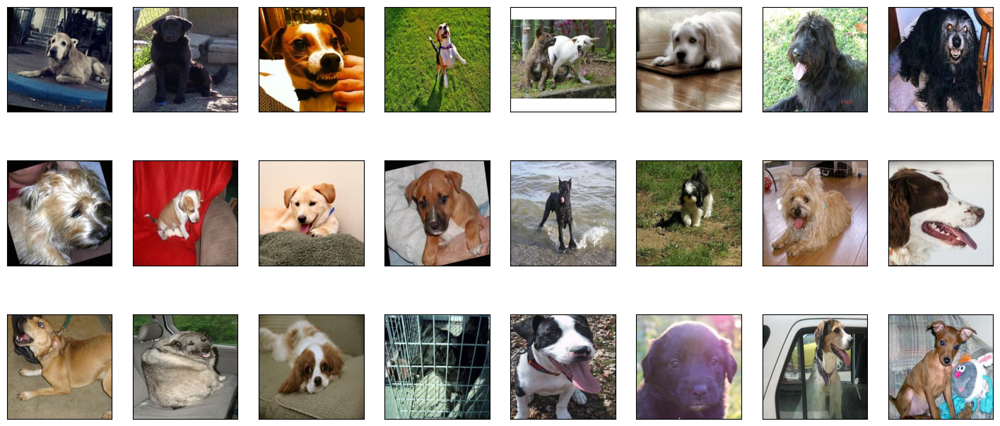

In [30]:
plot_sample_images(dog_emotions['image'].values)

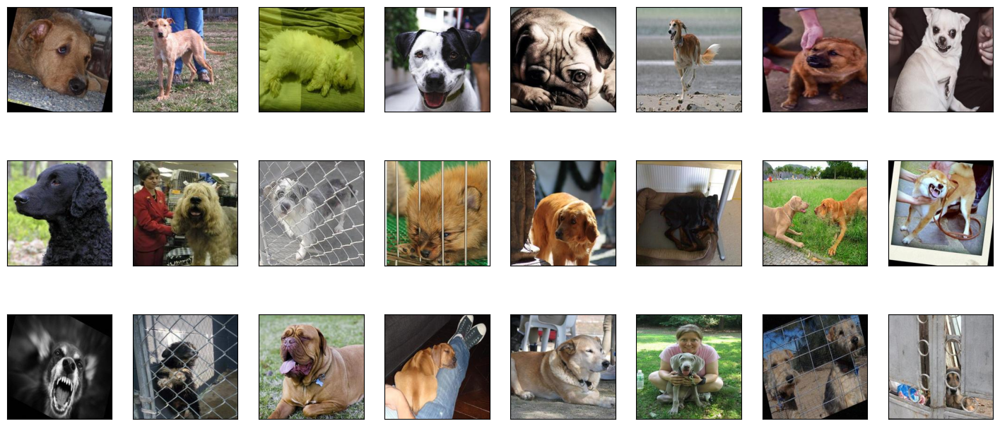

In [31]:
plot_sample_images(removed_images['image'].values)

It is clear that the majority of the removed images were ones in which the dog's face was not clearly visible, there were people present, or the image quality was not good. There is a small margin of error, so some quality images may have been removed. Fortunately, this is a rare occurrence.

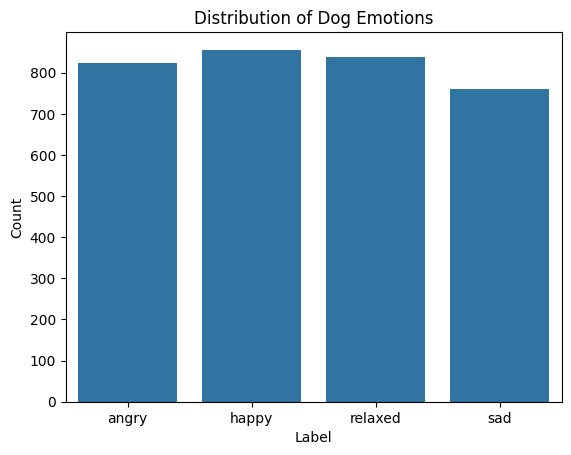

In [32]:
sns.countplot(x='label', data=dog_emotions)

plt.title('Distribution of Dog Emotions')
plt.xlabel('Label')
plt.ylabel('Count')

plt.show()

The visualization indicates that the distribution of labels has remained mostly unchanged after the cleaning process, suggesting that it will not impact the training process significantly.

# Prepocessing <a class="anchor" id="preprocessing"></a>

In [33]:
encoder = LabelEncoder()

dog_emotions['label_id'] = encoder.fit_transform(dog_emotions['label'])

In [34]:
X = np.array(dog_emotions['image'].tolist())
y = dog_emotions['label_id'].values

## Splitting into Train/Test/Validation <a class="anchor" id="splitting"></a>

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=0)

# Baseline CNN <a class="anchor" id="baseline-cnn"></a>

For a baseline model, a simple `CNN` (Convolutional Neural Network) has been selected.

## Modelling <a class="anchor" id="modelling-baseline-cnn"></a>

In [36]:
num_classes = 4 
batch_size = 32

In [37]:
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')])

c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [38]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [39]:
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 20s 308ms/step - accuracy: 0.2607 - loss: 46.3970 - val_accuracy: 0.2835 - val_loss: 1.3506
Epoch 2/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 308ms/step - accuracy: 0.4186 - loss: 1.2422 - val_accuracy: 0.3384 - val_loss: 1.3384
Epoch 3/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 306ms/step - accuracy: 0.5203 - loss: 1.1275 - val_accuracy: 0.2942 - val_loss: 1.4551
Epoch 4/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 307ms/step - accuracy: 0.6146 - loss: 0.9160 - val_accuracy: 0.2851 - val_loss: 1.6516
Epoch 5/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 305ms/step - accuracy: 0.6991 - loss: 0.7516 - val_accuracy: 0.2927 - val_loss: 2.0494
Epoch 6/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 305ms/step - accuracy: 0.7878 - loss: 0.5671 - val_accuracy: 0.2896 - val_loss: 2.2970
Epoch 7/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 307ms/step - accuracy: 0.8359 - loss: 0.4498 - val_accuracy: 0.2774 - val_loss: 2.5469
Epoch 8/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 19s 306ms/step - accuracy: 0.8670 - loss: 0.3632 - val_acc

## Evaluation <a class="anchor" id="evaluation-baseline-cnn"></a>

In [40]:
test_loss, test_accuracy = model.evaluate(X_test, y_test)

print(f'Accuracy: {test_accuracy}')

21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 84ms/step - accuracy: 0.3174 - loss: 3.0851
Accuracy: 0.33993902802467346


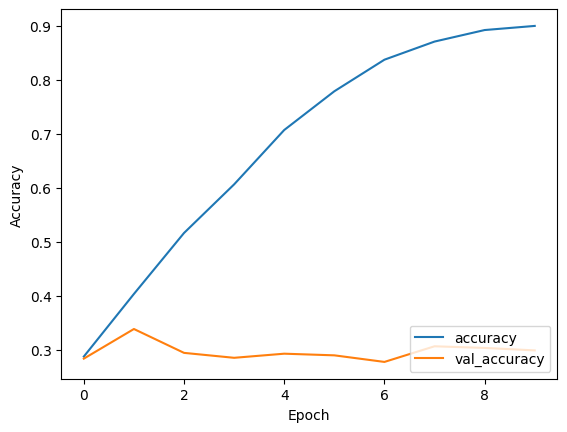

In [41]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

During the training process, the model's performance metrics are tracked across multiple epochs. Initially, the model shows gradual improvement in accuracy on the training data. However, as training continues, it becomes evident that the model is starting to overfit. This is indicated by a significant gap between the accuracy on the training data and the validation data. While the training accuracy continues to improve, the validation accuracy fluctuates or even declines, suggesting that the model might not generalize well to new, unseen data. This is also reflected in the loss metrics, where the training loss continues to decrease while the validation loss starts to increase.

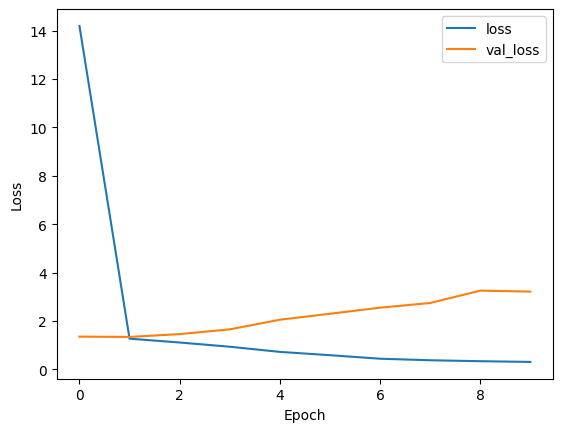

In [42]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [43]:
predictions = model.predict(X_test)
probabilities = tf.nn.softmax(predictions)

predicted_labels = np.argmax(predictions, axis=1)
predicted_probabilities = np.max(probabilities, axis=1)

21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step


Below the label IDs are mapped to their corresponding string representations.

In [44]:
label_map = dict(zip(dog_emotions['label_id'], dog_emotions['label']))

predicted_labels_text = np.array([label_map[label_id] for label_id in predicted_labels])
y_test_text = np.array([label_map[label_id] for label_id in y_test])

In [45]:
print(classification_report(y_test_text, predicted_labels_text))

              precision    recall  f1-score   support

       angry       0.34      0.38      0.36       169
       happy       0.37      0.36      0.36       181
     relaxed       0.28      0.32      0.30       144
         sad       0.37      0.29      0.32       162

    accuracy                           0.34       656
   macro avg       0.34      0.34      0.34       656
weighted avg       0.34      0.34      0.34       656



The classification report shows that the model's predictions are balanced across all classes, with similar levels of precision, recall, and F1-score for each emotional category.

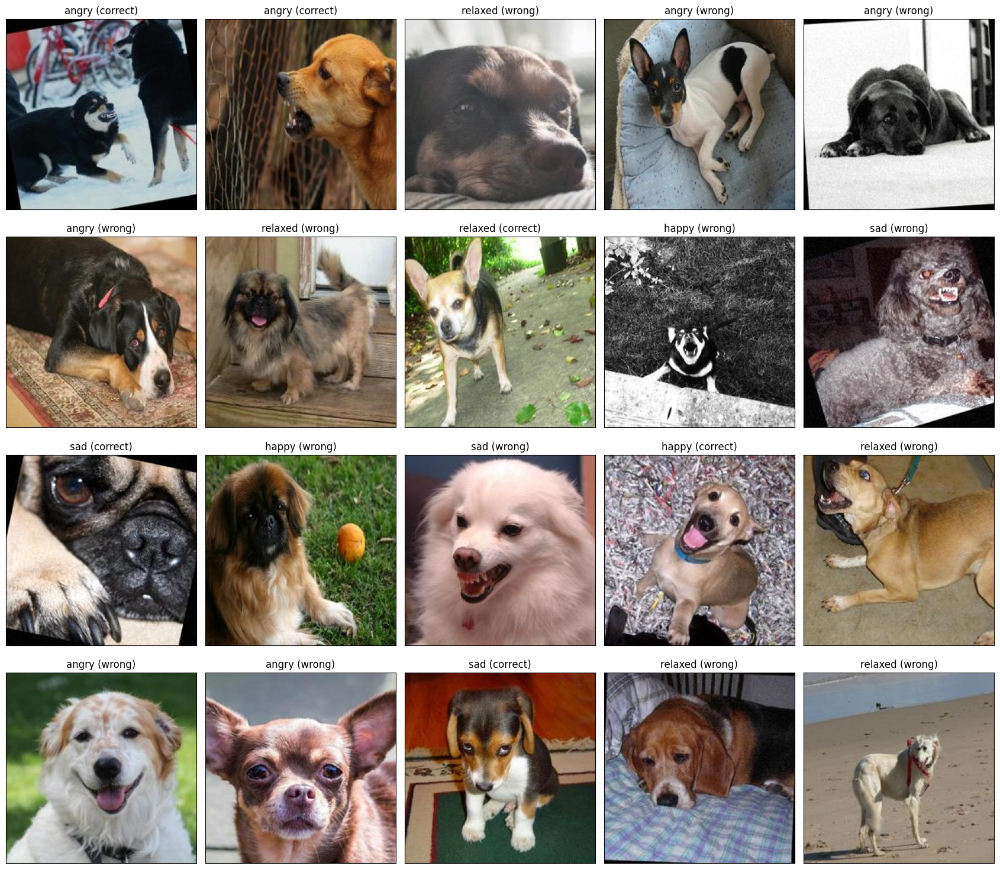

In [46]:
size = 224

num_samples = 20
random_indices = np.random.choice(len(X_test), size=num_samples, replace=False)

_, subplots = plt.subplots(nrows=4, ncols=5, figsize=(17, 15))

for i, idx in enumerate(random_indices):
    row = i // 5
    col = i % 5
    subplots[row, col].imshow(X_test[idx])
    subplots[row, col].set_xticks([])
    subplots[row, col].set_yticks([])
    subplots[row, col].set_title(
        str(predicted_labels_text[idx]) + (" (correct)" if predicted_labels[idx] == y_test[idx] else " (wrong)")
    )

plt.tight_layout()
plt.show()

## Conclusion <a class="anchor" id="conclusion-baseline-cnn"></a>

In conclusion, the baseline model shows reasonably consistent predictions in all classes, indicating it maintains a balanced approach in its classifications. However, the noticeable overfitting suggests it is too focused on details within the training dataset, which may limit its ability to generalize effectively to new, unseen data. Addressing this overfitting issue is crucial for improving the model's reliability and ensuring it performs well across different scenarios and datasets.

# CNN with Data Augmentation <a class="anchor" id="cnn-with-data-augmentation"></a>

In [47]:
batch_size = 32

## Data Augmentation <a class="anchor" id="data-augmentation-cnn-with-data-augmentation"></a>

The `train_datagen` rescales the pixel values of the images to a range of [0, 1] as a form of normalization which was suggested during the Data Understanding phase. It also applies several other augmentation techniques such as rotation, zoom, horizontal flip.

These augmentation techniques help the model generalize better by exposing it to various transformations of the training data, thereby reducing overfitting and improving its ability to recognize patterns in new, unseen images.

In [48]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,  
    shear_range=0.2,    
    zoom_range=0.2,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

validation_datagen = ImageDataGenerator(rescale=1./255)

In [49]:
train_generator = train_datagen.flow(
    X_train,
    y_train,
    batch_size=batch_size,
    shuffle=True
)

validation_generator = validation_datagen.flow(
    X_val,
    y_val,
    batch_size=batch_size,
    shuffle=False
)

To evaluate the effectiveness of data augmentation, a random image from the training set is selected and different augmentation techniques are applied to it. This observation implies that the selected augmentations successfully diversify the training data while preserving its natural characteristics.

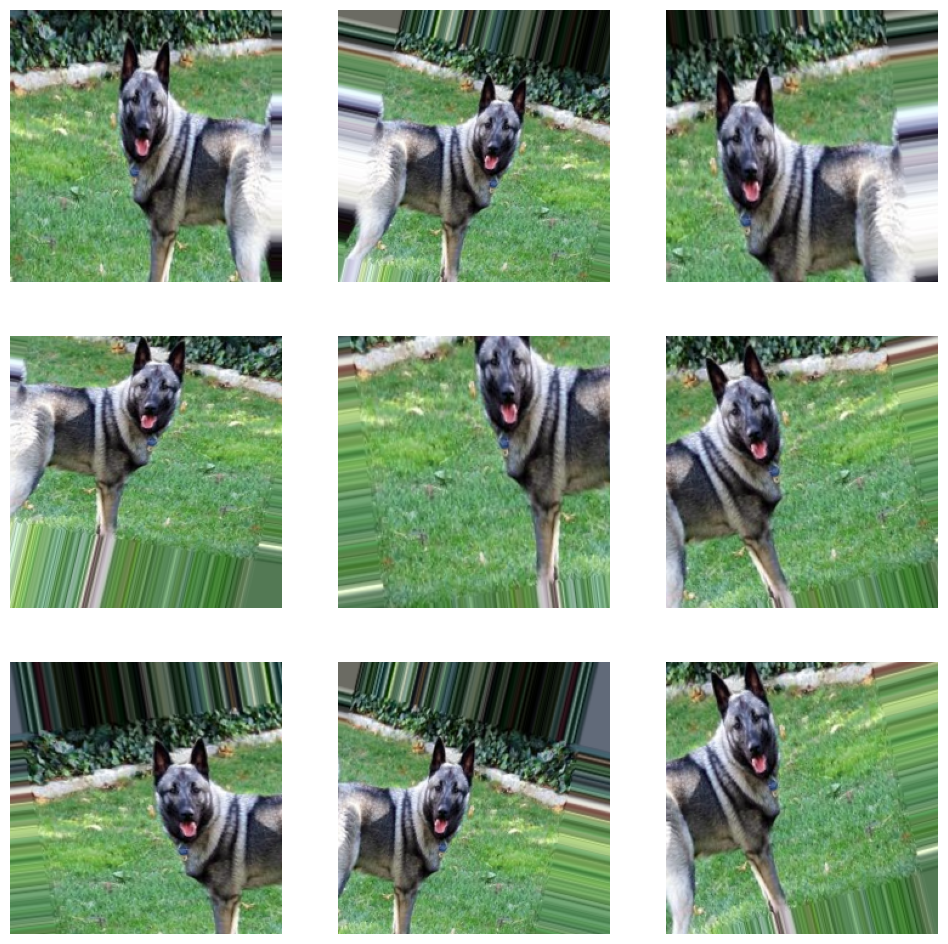

In [50]:
random_index = random.randint(0, len(X_train) - 1)
sample = X_train[random_index]

sample_image = np.expand_dims(sample, axis=0)

aug_iter = train_datagen.flow(sample_image)

plt.figure(figsize=(12, 12))
for i in range(9):
    aug_image = next(aug_iter)[0]
    plt.subplot(3, 3, i + 1)
    plt.imshow(aug_image)
    plt.axis('off')
plt.show()

## Modelling <a class="anchor" id="modelling-data-augmentation-cnn"></a>

In [51]:
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')])

c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [52]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [53]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(X_train)//batch_size,
    validation_data=validation_generator,
    validation_steps=len(X_val)//batch_size,
    epochs=10
)

Epoch 1/10


c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


61/61 ━━━━━━━━━━━━━━━━━━━━ 29s 437ms/step - accuracy: 0.2694 - loss: 1.4771 - val_accuracy: 0.3344 - val_loss: 1.3659
Epoch 2/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.2812 - loss: 1.3122 - val_accuracy: 0.1875 - val_loss: 1.3782
Epoch 3/10


c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


61/61 ━━━━━━━━━━━━━━━━━━━━ 28s 428ms/step - accuracy: 0.3564 - loss: 1.3283 - val_accuracy: 0.3141 - val_loss: 1.3381
Epoch 4/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 842us/step - accuracy: 0.4062 - loss: 1.2660 - val_accuracy: 0.3750 - val_loss: 1.3559
Epoch 5/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 28s 434ms/step - accuracy: 0.3380 - loss: 1.3132 - val_accuracy: 0.3016 - val_loss: 1.3430
Epoch 6/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 788us/step - accuracy: 0.3438 - loss: 1.2768 - val_accuracy: 0.5000 - val_loss: 1.3630
Epoch 7/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 28s 438ms/step - accuracy: 0.3575 - loss: 1.2921 - val_accuracy: 0.3063 - val_loss: 1.3319
Epoch 8/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 950us/step - accuracy: 0.1250 - loss: 1.3822 - val_accuracy: 0.5000 - val_loss: 1.3566
Epoch 9/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 28s 432ms/step - accuracy: 0.3383 - loss: 1.2876 - val_accuracy: 0.3297 - val_loss: 1.3223
Epoch 10/10
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 807us/step - accuracy: 0.4375 - loss: 1.2426 - val_accuracy: 0.5625 -

## Evaluation <a class="anchor" id="evaluation-data-augmentation-cnn"></a>

In [54]:
X_test_normalized = X_test / 255.0

In [55]:
test_loss, test_accuracy = model.evaluate(X_test_normalized, y_test)

print(f'Accuracy: {test_accuracy}')

21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 100ms/step - accuracy: 0.3516 - loss: 1.3209
Accuracy: 0.3628048896789551


By looking at the training epochs and accuracy it is evident that this model shows several improvements compared to the baseline model. The validation accuracy and loss metrics demonstrate more stable behavior across epochs compared to the baseline model. While there are fluctuations, the accuracy and the validation accuracy are generally more stable, indicating better generalization to unseen data.

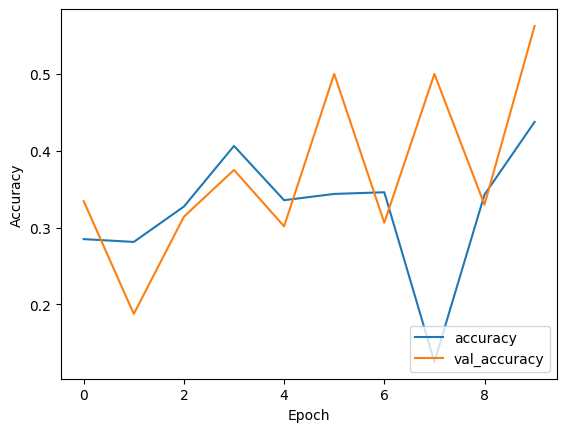

In [56]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

Unlike the baseline model, where the training accuracy rapidly increased while validation accuracy fluctuated or declined, this model shows more balanced results in both training and validation accuracy. This suggests that the model is learning patterns that are more likely to generalize to new examples and shows signs of reduced overfitting.

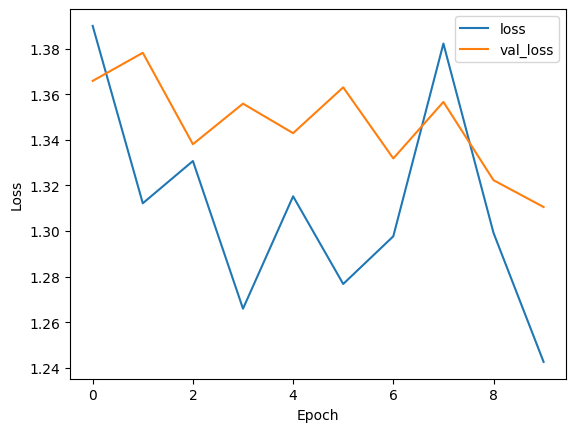

In [57]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [58]:
predictions = model.predict(X_test_normalized)
probabilities = tf.nn.softmax(predictions)

predicted_labels = np.argmax(predictions, axis=1)
predicted_probabilities = np.max(probabilities, axis=1)

21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 101ms/step


In [59]:
label_map = dict(zip(dog_emotions['label_id'], dog_emotions['label']))

predicted_labels_text = np.array([label_map[label_id] for label_id in predicted_labels])
y_test_text = np.array([label_map[label_id] for label_id in y_test])

In [60]:
print(classification_report(y_test_text, predicted_labels_text))

              precision    recall  f1-score   support

       angry       0.45      0.34      0.39       169
       happy       0.34      0.86      0.49       181
     relaxed       0.31      0.11      0.16       144
         sad       0.39      0.06      0.10       162

    accuracy                           0.36       656
   macro avg       0.37      0.34      0.29       656
weighted avg       0.38      0.36      0.30       656



Despite improvements observed in training stability and generalization with data augmentation, the classification report indicates challenges in effectively classifying all emotion categories. Notably, while the accuracy stays almost the same as the one of the baseline model, there is a notable challenge in predicting the majority of the labels, with a considerable drop in recall.

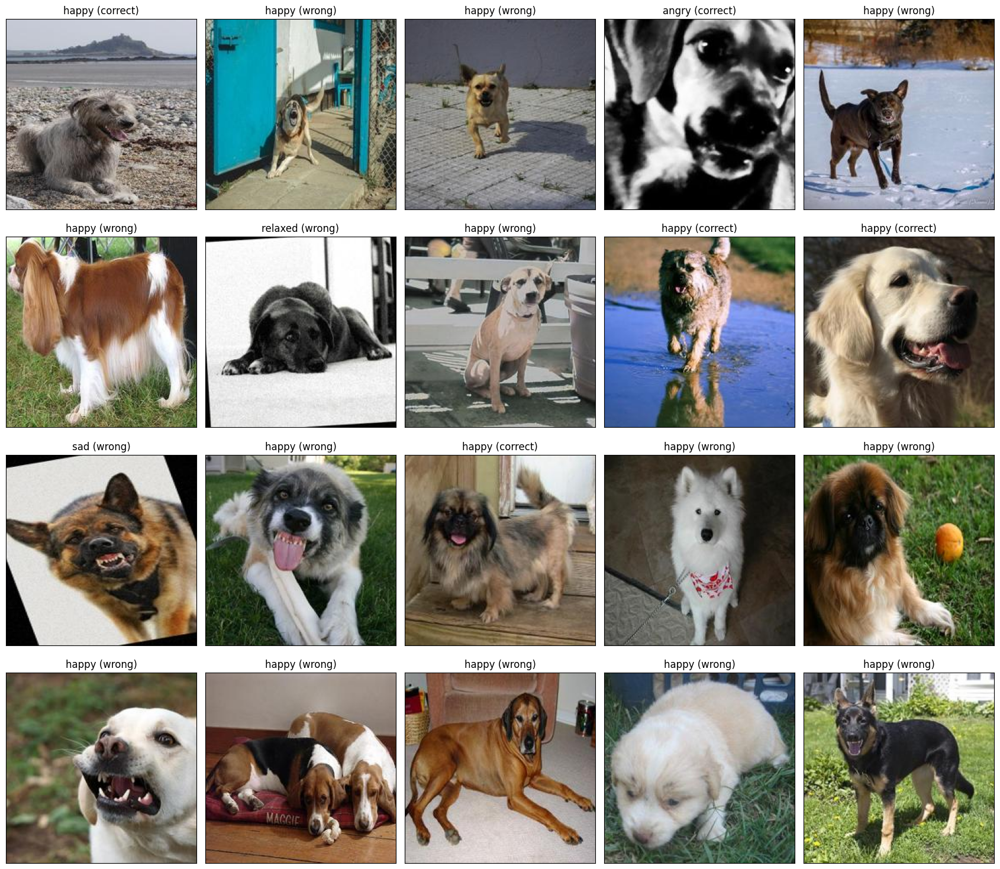

In [61]:
size = 224

num_samples = 20
random_indices = np.random.choice(len(X_test), size=num_samples, replace=False)

_, subplots = plt.subplots(nrows=4, ncols=5, figsize=(17, 15))

for i, idx in enumerate(random_indices):
    row = i // 5
    col = i % 5
    subplots[row, col].imshow(X_test[idx])
    subplots[row, col].set_xticks([])
    subplots[row, col].set_yticks([])
    subplots[row, col].set_title(
        str(predicted_labels_text[idx]) + (" (correct)" if predicted_labels[idx] == y_test[idx] else " (wrong)")
    )

plt.tight_layout()
plt.show()

## Conclusion <a class="anchor" id="conclusion--data-augmentation-cnn"></a>

In conclusion, there are improvements in generalisation, fewer indications of overfitting, and more consistent accuracy scores when training epochs with data augmentation. These improvements highlight how effectively data augmentation works to raise the robustness of the model.

However, in contrast to the baseline model, the classification report of this model shows some ongoing difficulties in accurately classifying some emotion categories. These challenges need to be addressed through further refinement of the model.

# CNN with VGG16 Convolutional Base <a class="anchor" id="cnn-vgg16-base"></a>

By incorporating `VGG16`'s pre-trained weights, which have been trained on a diverse set of ImageNet images, the model can efficiently learn and extract meaningful features from emotional expressions. This approach will allow the model to learn the patterns associated with different emotions more effectively which could potentially lead to improving its ability to classify emotions accurately even with complex visual features.

In [62]:
batch_size = 32

In [63]:
conv_base = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

## Data Augmentation <a class="anchor" id="data-augmentation-cnn-vgg16-base"></a>

To address the fluctuations in accuracy, the data augmentation has been made less intense.

In [64]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,  
    shear_range=0.1, 
    zoom_range=0.1, 
    width_shift_range=0.1,  
    height_shift_range=0.1,  
    horizontal_flip=True,
    fill_mode='nearest'
)

validation_datagen = ImageDataGenerator(rescale=1./255)


In [65]:
train_generator = train_datagen.flow(
    X_train,
    y_train,
    batch_size=batch_size,
    shuffle=True
)

validation_generator = validation_datagen.flow(
    X_val,
    y_val,
    batch_size=batch_size,
    shuffle=False
)

## Modelling <a class="anchor" id="modelling-cnn-vgg16-base"></a>

Freezing the convolutional base helps prevent overfitting while setting the `learning_rate` to `0.0001` ensures that the model makes gradual adjustments to its parameters. This approach is crucial when building on top of a pre-trained model like `VGG16`, which already possesses valuable learned features.

In [66]:
conv_base.trainable = False

model = tf.keras.Sequential([
    conv_base,
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')
])

In [67]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

Since this model uses the `VGG16` convolutional base the `epochs` parameter will be set to `20` in order to allow more time for the model to further refine its performance.

In [68]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(X_train)//batch_size,
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(X_val)//batch_size)

Epoch 1/20


c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


61/61 ━━━━━━━━━━━━━━━━━━━━ 133s 2s/step - accuracy: 0.3423 - loss: 1.5387 - val_accuracy: 0.4953 - val_loss: 1.1621
Epoch 2/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 1:35 2s/step - accuracy: 0.5312 - loss: 1.1530

c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


61/61 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.5312 - loss: 1.1530 - val_accuracy: 0.6250 - val_loss: 1.0376
Epoch 3/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 129s 2s/step - accuracy: 0.4556 - loss: 1.1871 - val_accuracy: 0.5266 - val_loss: 1.0947
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.5312 - loss: 1.0530 - val_accuracy: 0.4375 - val_loss: 1.0691
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 129s 2s/step - accuracy: 0.4894 - loss: 1.1460 - val_accuracy: 0.5703 - val_loss: 1.0467
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.4688 - loss: 1.0576 - val_accuracy: 0.5625 - val_loss: 1.0099
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 129s 2s/step - accuracy: 0.5522 - loss: 1.0382 - val_accuracy: 0.5969 - val_loss: 1.0186
Epoch 8/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.5625 - loss: 1.0879 - val_accuracy: 0.5000 - val_loss: 1.0011
Epoch 9/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 134s 2s/step - accuracy: 0.5821 - loss: 0.9719 - val_accuracy: 0.5719 - val_loss: 1.

## Evaluation <a class="anchor" id="evaluation-cnn-vgg16-base"></a>

In [69]:
X_test_normalized = X_test / 255.0

In [70]:
test_loss, test_accuracy = model.evaluate(X_test_normalized, y_test)

print(f'Accuracy: {test_accuracy}')

21/21 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.6115 - loss: 0.9001
Accuracy: 0.6234756112098694


The model showed a significant increase in accuracy compared to the previous one which indicates substantial progress in the model's ability to learn and make accurate predictions.

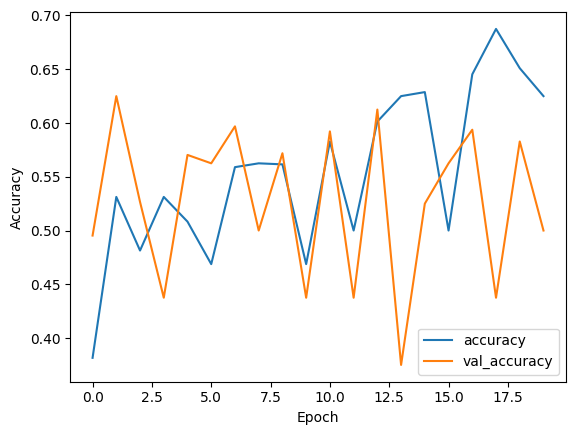

In [71]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

Regardless of the increase in the overall accuracy there are still a lot fluctuations in the performance of the model which suggests that further refinements are necessary.

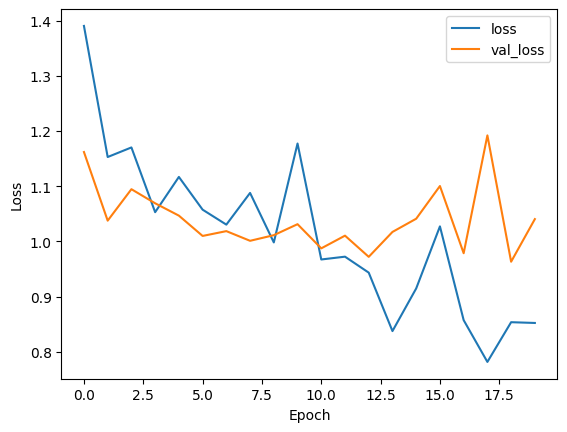

In [72]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

It is visible in the visualization above that despite the fluctuations the overall, the loss is decreasing over the course of training.

In [73]:
predictions = model.predict(X_test_normalized)
probabilities = tf.nn.softmax(predictions)

predicted_labels = np.argmax(predictions, axis=1)
predicted_probabilities = np.max(probabilities, axis=1)

21/21 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step


In [74]:
label_map = dict(zip(dog_emotions['label_id'], dog_emotions['label']))

predicted_labels_text = np.array([label_map[label_id] for label_id in predicted_labels])
y_test_text = np.array([label_map[label_id] for label_id in y_test])

In [75]:
print(classification_report(y_test_text, predicted_labels_text))

              precision    recall  f1-score   support

       angry       0.67      0.54      0.60       169
       happy       0.58      0.69      0.63       181
     relaxed       0.61      0.44      0.51       144
         sad       0.65      0.80      0.71       162

    accuracy                           0.62       656
   macro avg       0.63      0.62      0.61       656
weighted avg       0.63      0.62      0.62       656



The precision values have generally increased across all emotion categories. Additionally, recall has greatly improved as well. Although the model still predicts some labels worse that others, the recent improvements indicate that the model can now distinguish them more accurately.

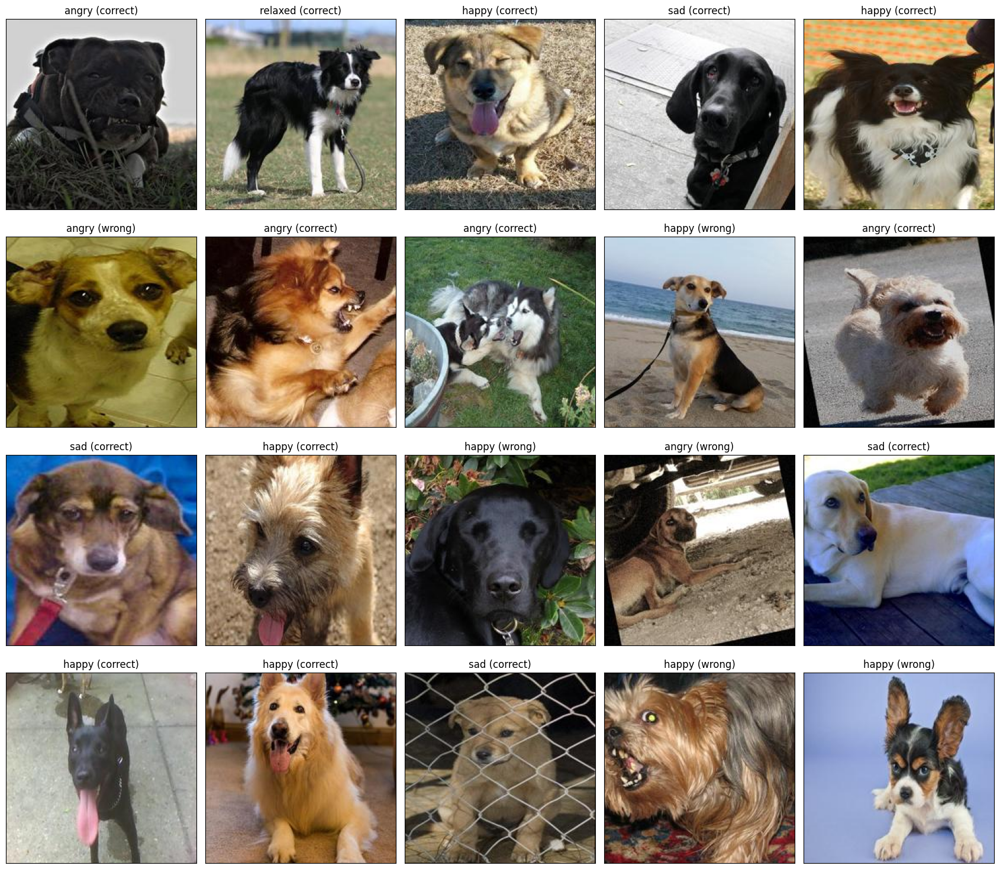

In [76]:
size = 224

num_samples = 20
random_indices = np.random.choice(len(X_test), size=num_samples, replace=False)

_, subplots = plt.subplots(nrows=4, ncols=5, figsize=(17, 15))

for i, idx in enumerate(random_indices):
    row = i // 5
    col = i % 5
    subplots[row, col].imshow(X_test[idx])
    subplots[row, col].set_xticks([])
    subplots[row, col].set_yticks([])
    subplots[row, col].set_title(
        str(predicted_labels_text[idx]) + (" (correct)" if predicted_labels[idx] == y_test[idx] else " (wrong)")
    )

plt.tight_layout()
plt.show()

## Conclusion <a class="anchor" id="conclusion-cnn-vgg16-base"></a>

In summary, this model exhibits significant improvements in precision, recall, F1-score, and overall accuracy compared to the previous version. These enhancements signify better performance in accurately classifying various emotions.

However, exploring different options for further refinement is necessary to enhance the model's performance and address the fluctuations in accuracy.

# Refined Data Preparation <a class="anchor" id="refined-data-preparation"></a>

## Object Detection and Dog Face Extraction using YOLOv3 <a class="anchor" id="dog-face-extraction"></a>

The function `extract_dog_faces` is designed to detect and extract dog faces using YOLOv3 with greater confidence threshold of `0.9` compared to before. Then it generates a new image that only contains the detected dog's face and body without the background of the original image to prevent the model from capturing noise.

In [77]:
def extract_dog_faces(image, confidence_threshold=0.9):
    height, width, channels = image.shape
    blob = cv2.dnn.blobFromImage(image, 1/255.0, (416, 416), swapRB=True, crop=False)
    net.setInput(blob)
    outs = net.forward(net.getUnconnectedOutLayersNames())
    
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if class_id == 16 and confidence > confidence_threshold:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    if len(boxes) == 0:
        return [] 
    
    indices = cv2.dnn.NMSBoxes(boxes, confidences, confidence_threshold, 0.4)
    
    faces = []
    if len(indices) > 0:
        for i in indices.flatten():
            box = boxes[i]
            x, y, w, h = box
            crop_img = image[y:y+h, x:x+w]
            faces.append(crop_img)
    
    return faces

A sample image is selected to verify that the function works as intended.

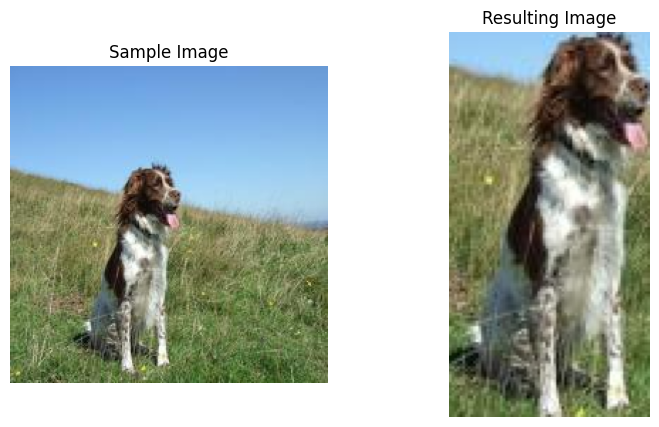

In [168]:
sample_row = dog_emotions.sample().iloc[0]

fig, axes = plt.subplots(1, 2, figsize=(9, 5))

axes[0].imshow(np.array(sample_row['image']))
axes[0].set_title('Sample Image')
axes[0].axis('off')

dog_faces = extract_dog_faces(sample_row['image'])

if len(dog_faces) == 0 or dog_faces[0].size == 0:
    print('No dog detected with 0.9 confidence threshold')
    axes[1].axis('off')  
else:
    axes[1].imshow(np.array(dog_faces[0]))
    axes[1].set_title('Resulting Image')
    axes[1].axis('off')

In [79]:
dog_faces_data = []

for index, row in dog_emotions.iterrows():
    img = row['image']
    label = row['label']

    dog_faces = extract_dog_faces(img)

    if len(dog_faces) == 0 or dog_faces[0].size == 0:
        continue  

    for face in dog_faces:
        dog_faces_data.append({'image': face, 'label': label})

dog_emotions_faces = pd.DataFrame(dog_faces_data)

cv2.destroyAllWindows()

In [80]:
empty_count = sum(dog_emotions_faces['image'].apply(lambda x: x.size == 0))
print(f"Number of empty arrays: {empty_count}")

Number of empty arrays: 4


In [81]:
dog_emotions_faces = dog_emotions_faces[dog_emotions_faces['image'].apply(lambda x: x.size > 0)]

In [82]:
def resize_image(image, target_size=(224, 224)):
    return cv2.resize(image, target_size)

After the new images are generated, it must be ensured that they are all the same size.

In [83]:
dog_emotions_faces['image'] = dog_emotions_faces['image'].apply(lambda img: resize_image(img))

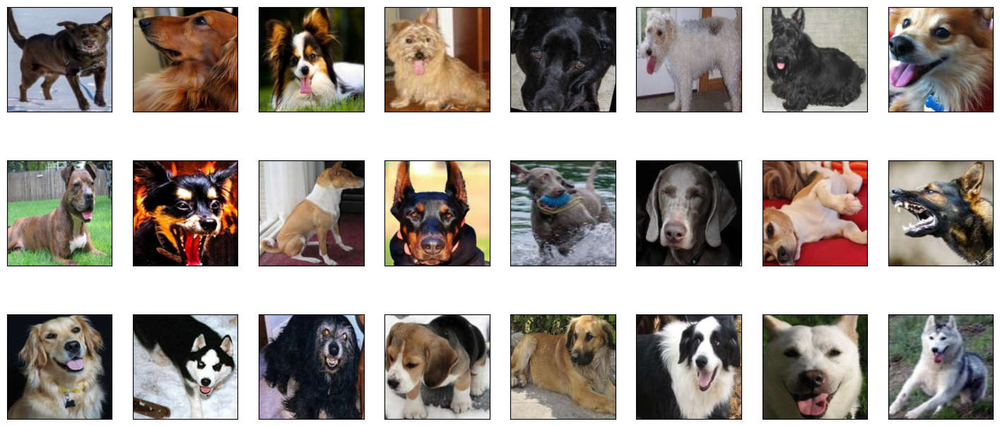

In [84]:
plot_sample_images(dog_emotions_faces['image'].values)

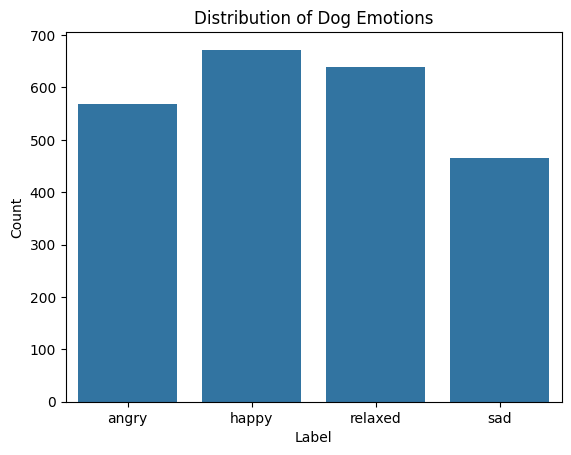

In [85]:
sns.countplot(x='label', data=dog_emotions_faces)

plt.title('Distribution of Dog Emotions')
plt.xlabel('Label')
plt.ylabel('Count')

plt.show()

The visualizations shows that the generation of the new images has resulted in an imbalance in the distribution of labels. This imbalance could potentially impact the performance of the model and therefore needs to be addressed.

## Oversampling <a class="anchor" id="oversampling"></a>

To address the issue of imbalanced label distribution resulting from the generation of new images, an oversampling technique will be employed using data augmentation. This technique aims to increase the sample count of labels with fewer samples to match the one with the highest sample count.

A couple of augmentation techniques will be used. However, the `zoom` augmentation will not be included, as the images have already been cropped to focus solely on the dog's face. Further zooming could potentially distort or obscure the facial features, making them less recognizable.

In [86]:
datagen = ImageDataGenerator(
    rotation_range=10,  
    shear_range=0.1, 
    width_shift_range=0.1,  
    height_shift_range=0.1,  
    horizontal_flip=True,
    fill_mode='nearest'
)

In [87]:
def augment_images(image_array, target_class, target_count):
    current_count = len(image_array)
    augmented_images = []
    augmented_labels = []
    
    while current_count < target_count:
        for img in image_array:
            img = img.reshape((1,) + img.shape)
            
            for batch in datagen.flow(img, batch_size=1):
                augmented_img = batch[0]
                augmented_img = np.clip(augmented_img, 0, 255)
                augmented_img = augmented_img.astype(np.uint8)
                augmented_images.append(augmented_img)
                augmented_labels.append(target_class)
                current_count += 1
                if current_count >= target_count:
                    break
            if current_count >= target_count:
                break
    
    return np.array(augmented_images), np.array(augmented_labels)


In [88]:
label_counts = dog_emotions_faces['label'].value_counts()
target_count = label_counts.max()
max_label = label_counts.idxmax()  

augmented_images_list = []
augmented_labels_list = []

for label in label_counts.index:
    if label != max_label and label_counts[label] < target_count:
        image_array = np.stack(dog_emotions_faces[dog_emotions_faces['label'] == label]['image'].values)
        aug_images, aug_labels = augment_images(image_array, label, target_count)
        augmented_images_list.append(aug_images)
        augmented_labels_list.append(aug_labels)

augmented_images = np.concatenate(augmented_images_list, axis=0)
augmented_labels = np.concatenate(augmented_labels_list, axis=0)

final_images = np.concatenate((np.stack(dog_emotions_faces['image'].values), augmented_images), axis=0)
final_labels = np.concatenate((dog_emotions_faces['label'].values, augmented_labels), axis=0)

indices = np.arange(len(final_labels))
np.random.shuffle(indices)
final_images = final_images[indices]
final_labels = final_labels[indices]

balanced_dog_emotions_faces = pd.DataFrame({'image': list(final_images), 'label': final_labels})

After applying the oversampling technique, it is evident from the plot that the distribution of labels has been balanced, with each label now having an equal number of samples.

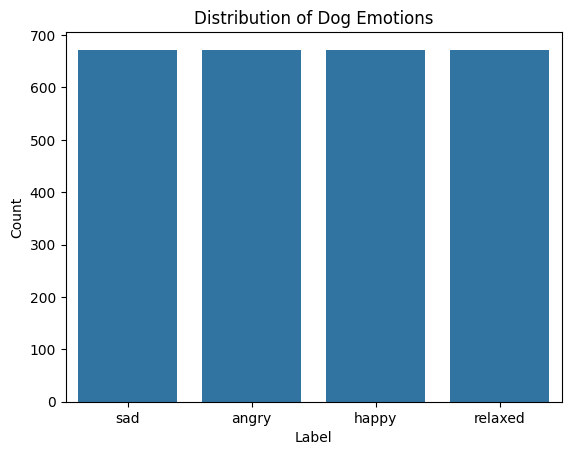

In [89]:
sns.countplot(x='label', data=balanced_dog_emotions_faces)

plt.title('Distribution of Dog Emotions')
plt.xlabel('Label')
plt.ylabel('Count')

plt.show()

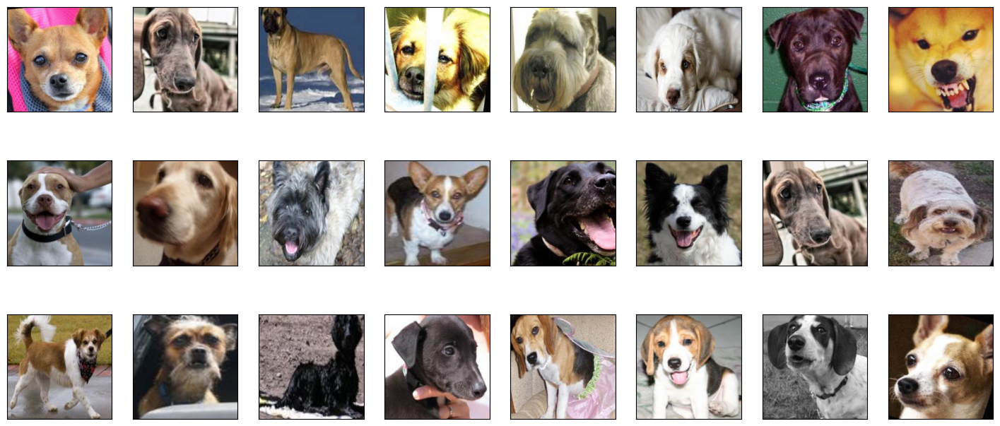

In [192]:
plot_sample_images(balanced_dog_emotions_faces['image'].values)

In [91]:
dog_emotions_faces = balanced_dog_emotions_faces.copy()

The resulting images are going to be saved in order to be used for training the machine learning models or further analysis without needing to regenerate the augmented data each time.

In [92]:
save_images_by_label(dog_emotions_faces, 'dog_emotions_faces')

## Loading the refined data <a class="anchor" id="loading-the-refined-data"></a>

In [93]:
dog_emotions_faces = load_images_from_folder('dog_emotions_faces')

# Preprocessing

In [94]:
encoder = LabelEncoder()

dog_emotions_faces['label_id'] = encoder.fit_transform(dog_emotions_faces['label'])

In [95]:
X = np.array(dog_emotions_faces['image'].tolist())
y = dog_emotions_faces['label_id'].values

## Splitting into Train/Test/Validation

This time, stratification is employed during the dataset splitting process to ensure balanced representation of each label across the training, validation, and test sets.

In [96]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=0, stratify=y_train)

# MobileNet <a class="anchor" id="mobilenet"></a>

In [97]:
num_classes = 4
batch_size = 32

In [135]:
base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

## Data Augmentation <a class="anchor" id="data-augmentation-mobilenet"></a>

The `zoom` augmentation, as before, is intentionally excluded from the data augmentation process due to the risk of further distorting the dog face images, which are already cropped to focus exclusively on the dog's facial features.

In [99]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,  
    shear_range=0.1, 
    width_shift_range=0.1,  
    height_shift_range=0.1,  
    horizontal_flip=True,
    fill_mode='nearest'
)

validation_datagen = ImageDataGenerator(rescale=1./255)

In [100]:
train_generator = train_datagen.flow(
    X_train,
    y_train,
    batch_size=batch_size,
    shuffle=True
)

validation_generator = validation_datagen.flow(
    X_val,
    y_val,
    batch_size=batch_size,
    shuffle=False
)

## Modelling <a class="anchor" id="modelling-mobilenet"></a>

Freezing all layers of the base `MobileNet` model allows leveraging its pre-trained features without modifying them. This method preserves the learned representations from the ImageNet dataset, which helps to prevent overfitting.

In [101]:
for layer in base_model.layers:
    layer.trainable = False

In [102]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

In [103]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

Early Stopping is a technique used to prevent overfitting by terminating training when the model's performance on unseen data stops improving.

It is going to be configured to monitor the validation loss (`val_loss`) and end the training process if the validation loss fails to show improvement over 5 consecutive epochs (`patience=5`). Therefore, the number of epochs will be set to a high number (`100`) to allow sufficient time for the model to learn and improve its performance.

In [104]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [105]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(X_train)//batch_size,
    epochs=100,
    validation_data=validation_generator,
    validation_steps=len(X_val)//batch_size,
    callbacks=[early_stopping])

Epoch 1/100


c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


50/50 ━━━━━━━━━━━━━━━━━━━━ 27s 436ms/step - accuracy: 0.2831 - loss: 1.5795 - val_accuracy: 0.5039 - val_loss: 1.1446
Epoch 2/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 249ms/step - accuracy: 0.4688 - loss: 1.1557

c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.4688 - loss: 1.1557 - val_accuracy: 0.4615 - val_loss: 1.2745
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 392ms/step - accuracy: 0.5318 - loss: 1.0678 - val_accuracy: 0.5527 - val_loss: 1.0310
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5625 - loss: 1.2172 - val_accuracy: 0.5000 - val_loss: 1.1703
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 388ms/step - accuracy: 0.6408 - loss: 0.9174 - val_accuracy: 0.5859 - val_loss: 0.9889
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5938 - loss: 0.9246 - val_accuracy: 0.5000 - val_loss: 1.0577
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 392ms/step - accuracy: 0.6630 - loss: 0.8339 - val_accuracy: 0.5918 - val_loss: 0.9627
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6562 - loss: 0.7412 - val_accuracy: 0.5769 - val_loss: 0.9769
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 389ms/step - accuracy: 0.6913 - loss: 0.7679 - val_accuracy: 0.6250 - v

## Evaluation <a class="anchor" id="evaluation-mobilenet"></a>

In [106]:
X_test_normalized = X_test / 255.0

In [107]:
test_loss, test_accuracy = model.evaluate(X_test_normalized, y_test)

print(f'Accuracy: {test_accuracy}')

17/17 ━━━━━━━━━━━━━━━━━━━━ 4s 228ms/step - accuracy: 0.6730 - loss: 0.8275
Accuracy: 0.702602207660675


This model demonstrates a clearer pattern of growth in accuracy and validation accuracy compared to previous models and also exhibits reduced fluctuations in both metrics.

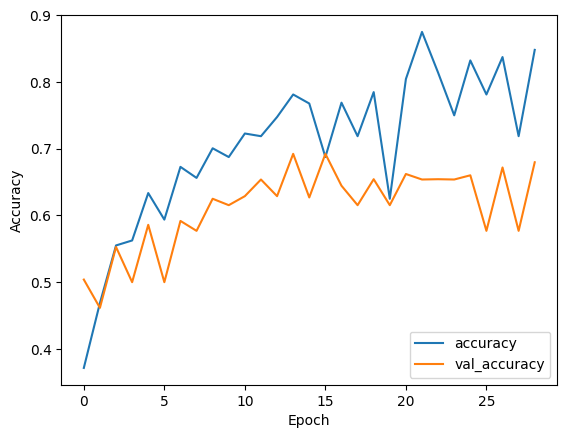

In [108]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

The loss and validation loss also show a consistent trend of decreasing, though still with some fluctuations which are less drastic compared to previous models.

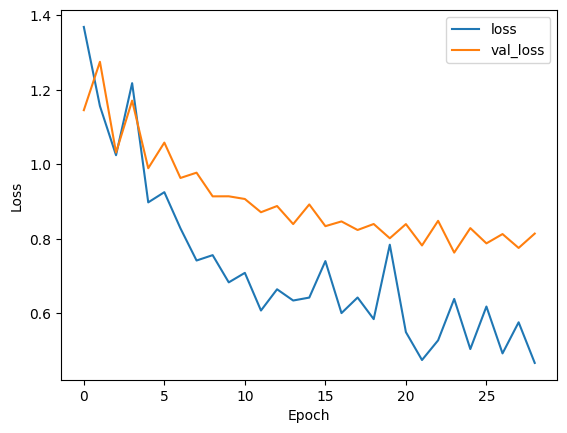

In [109]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [110]:
predictions = model.predict(X_test_normalized)
probabilities = tf.nn.softmax(predictions)

predicted_labels = np.argmax(predictions, axis=1)
predicted_probabilities = np.max(probabilities, axis=1)

17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 248ms/step


In [111]:
label_map = dict(zip(dog_emotions_faces['label_id'], dog_emotions_faces['label']))

predicted_labels_text = np.array([label_map[label_id] for label_id in predicted_labels])
y_test_text = np.array([label_map[label_id] for label_id in y_test])

In [112]:
print(classification_report(y_test_text, predicted_labels_text))

              precision    recall  f1-score   support

       angry       0.78      0.67      0.72       135
       happy       0.69      0.64      0.66       135
     relaxed       0.57      0.78      0.66       134
         sad       0.86      0.72      0.78       134

    accuracy                           0.70       538
   macro avg       0.72      0.70      0.71       538
weighted avg       0.72      0.70      0.71       538



This model exhibits a balanced performance across all emotion categories which seems to be better compared to the previous model. It also achieves better results in precision, recall and accuracy. Overall, the model appears to be reliable and robust in its predictions across a broader range of emotions.

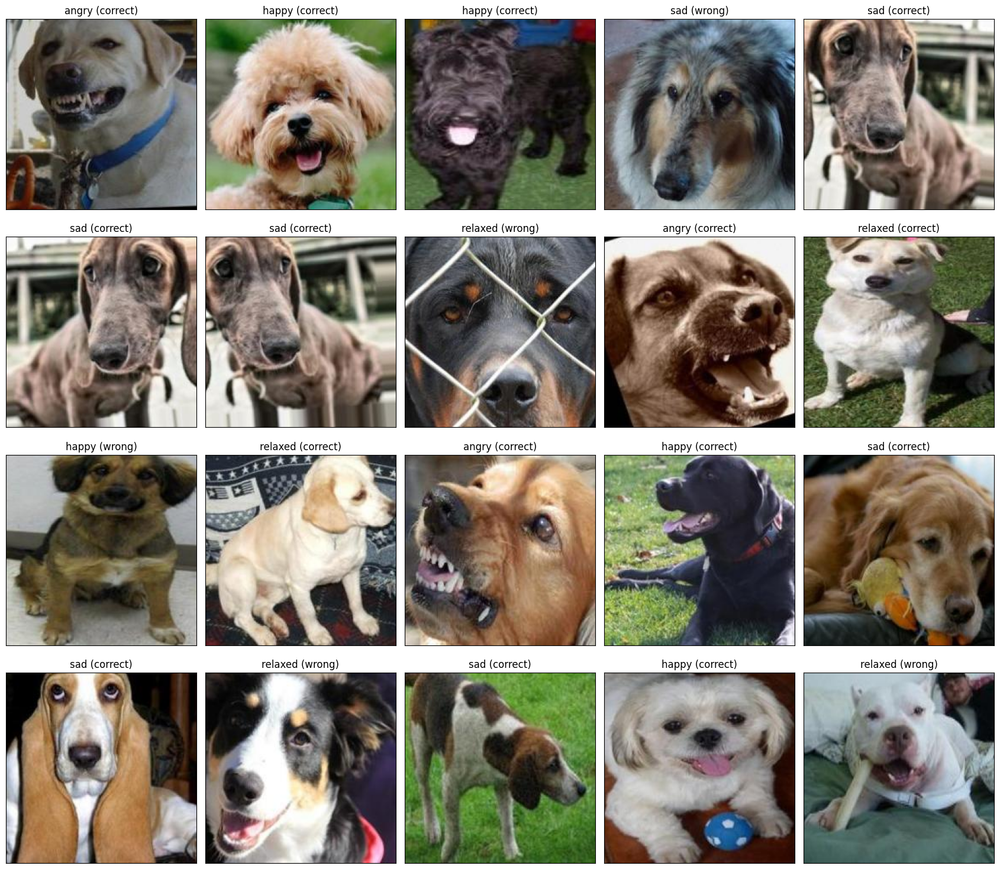

In [113]:
size = 224

num_samples = 20
random_indices = np.random.choice(len(X_test), size=num_samples, replace=False)

_, subplots = plt.subplots(nrows=4, ncols=5, figsize=(17, 15))

for i, idx in enumerate(random_indices):
    row = i // 5
    col = i % 5
    subplots[row, col].imshow(X_test[idx])
    subplots[row, col].set_xticks([])
    subplots[row, col].set_yticks([])
    subplots[row, col].set_title(
        str(predicted_labels_text[idx]) + (" (correct)" if predicted_labels[idx] == y_test[idx] else " (wrong)")
    )

plt.tight_layout()
plt.show()

## Conclusion <a class="anchor" id="conclusion-mobilenet"></a>

In conclusion, `MobileNet` demonstrates promising results by addressing issues related to significant fluctuations in accuracy metrics, showing improved consistency. The `accuracy` and `val_accuracy` now show clear growth which is a significant improvement over previous models that exhibited fluctuating results without a distinct pattern. This suggests potential stability and reliability in the model's performance.

However, despite these improvements and the improvements in accuracy, further fine-tuning could be beneficial to optimize its performance.

# MobileNet with Fine-Tuning <a class="anchor" id="mobilenet-fine-tune"></a>

Since all layers of the base model were previously frozen, and the same base is being used for the current model, the layers remain frozen as indicated below.

In [171]:
frozen_count = sum([1 for layer in base_model.layers if not layer.trainable])
trainable_count = sum([1 for layer in base_model.layers if layer.trainable])

print(f"Number of frozen layers in base_model: {frozen_count}")
print(f"Number of trainable layers in base_model: {trainable_count}")

Number of frozen layers in base_model: 86
Number of trainable layers in base_model: 0


## Data Augmentation <a class="anchor" id="data-augmentation-mobilenet-fine-tune"></a>

In [172]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,  
    shear_range=0.2, 
    width_shift_range=0.2,  
    height_shift_range=0.2,  
    horizontal_flip=True,
    fill_mode='nearest'
)

validation_datagen = ImageDataGenerator(rescale=1./255)

In [173]:
train_generator = train_datagen.flow(
    X_train,
    y_train,
    batch_size=batch_size,
    shuffle=True
)

validation_generator = validation_datagen.flow(
    X_val,
    y_val,
    batch_size=batch_size,
    shuffle=False
)

## Modelling <a class="anchor" id="modelling-mobilenet-fine-tune"></a>

For fine-tuning, the last 20 layers of the `MobileNet` base model will be unfrozen. Those specific layers are chosen due to a couple of reasons.

The initial layers in `MobileNet` are designed to capture fundamental and general features like edges, textures, and basic patterns, which are applicable across diverse datasets and tasks. If these layers are unfrozen and allowed to update too freely, the model may start to memorize the training data rather than learning generalizable features.

On the other hand, the deeper layers of `MobileNet` learn more specific features that are more adapted to the variations of the dataset they were trained on, such as ImageNet. By unfreezing these later layers, the model will be enabled to adapt and refine these specialized representations to better suit the specific requirements of dog emotion recognition.

In [174]:
for layer in base_model.layers[-20:]:
    layer.trainable = True

In [175]:
frozen_count = sum([1 for layer in base_model.layers if not layer.trainable])
trainable_count = sum([1 for layer in base_model.layers if layer.trainable])

print(f"Number of frozen layers in base_model: {frozen_count}")
print(f"Number of trainable layers in base_model: {trainable_count}")

Number of frozen layers in base_model: 66
Number of trainable layers in base_model: 20


In [176]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

In [177]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [178]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [179]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(X_train)//batch_size,
    epochs=100,
    validation_data=validation_generator,
    validation_steps=len(X_val)//batch_size,
    callbacks=[early_stopping])

Epoch 1/100


c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


50/50 ━━━━━━━━━━━━━━━━━━━━ 28s 464ms/step - accuracy: 0.3893 - loss: 1.7449 - val_accuracy: 0.4609 - val_loss: 1.6891
Epoch 2/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 17s 352ms/step - accuracy: 0.4062 - loss: 1.4518

c:\Users\emily\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.4062 - loss: 1.4518 - val_accuracy: 0.5769 - val_loss: 1.2057
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 26s 485ms/step - accuracy: 0.5612 - loss: 1.2142 - val_accuracy: 0.5449 - val_loss: 1.2348
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7188 - loss: 0.7841 - val_accuracy: 0.6154 - val_loss: 0.8810
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 26s 483ms/step - accuracy: 0.6409 - loss: 0.9550 - val_accuracy: 0.5801 - val_loss: 1.2170
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5938 - loss: 1.0130 - val_accuracy: 0.6538 - val_loss: 0.9453
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 25s 483ms/step - accuracy: 0.6596 - loss: 0.8487 - val_accuracy: 0.6738 - val_loss: 0.8514
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7500 - loss: 0.7288 - val_accuracy: 0.6538 - val_loss: 0.8254
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 26s 485ms/step - accuracy: 0.7327 - loss: 0.6966 - val_accuracy: 0.7129 - v

## Evaluation <a class="anchor" id="evaluation-mobilenet-fine-tune"></a>

In [180]:
X_test_normalized = X_test / 255.0

In [181]:
test_loss, test_accuracy = model.evaluate(X_test_normalized, y_test)

print(f'Accuracy: {test_accuracy}')

17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 262ms/step - accuracy: 0.7550 - loss: 0.6675
Accuracy: 0.7825278639793396


It is evident that this model shows the highest test accuracy so far.

Given the growth trend in the accuracy metrics, despite some fluctuations, and considering the relatively small gap between `accuracy` and `val_accuracy`, along with the promising test accuracy, it appears that this model is not overfitting.

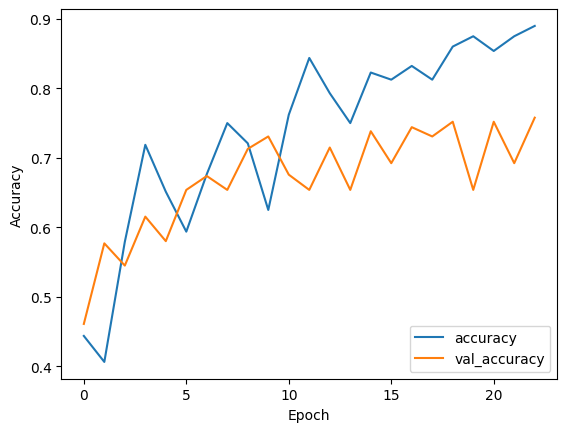

In [182]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

Moreover, the `val_loss` further supports this conclusion, as overfitting would typically cause the `val_loss` to increase.

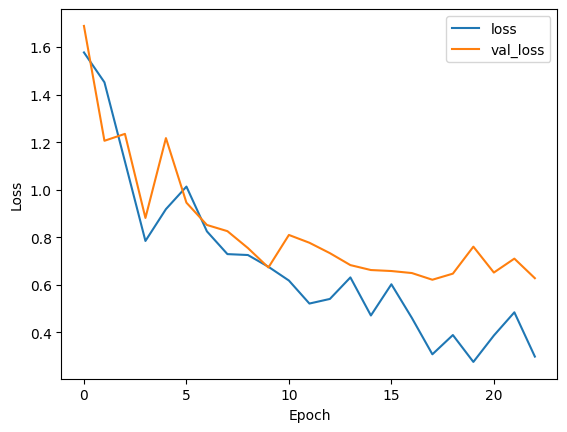

In [183]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [184]:
predictions = model.predict(X_test_normalized)
probabilities = tf.nn.softmax(predictions)

predicted_labels = np.argmax(predictions, axis=1)
predicted_probabilities = np.max(probabilities, axis=1)

17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 272ms/step


In [185]:
label_map = dict(zip(dog_emotions_faces['label_id'], dog_emotions_faces['label']))

predicted_labels_text = np.array([label_map[label_id] for label_id in predicted_labels])
y_test_text = np.array([label_map[label_id] for label_id in y_test])

In [186]:
print(classification_report(y_test_text, predicted_labels_text))

              precision    recall  f1-score   support

       angry       0.83      0.81      0.82       135
       happy       0.82      0.73      0.77       135
     relaxed       0.63      0.85      0.72       134
         sad       0.95      0.75      0.84       134

    accuracy                           0.78       538
   macro avg       0.81      0.78      0.79       538
weighted avg       0.81      0.78      0.79       538



The overall accuracy of this model is significantly better than the previous one, and this improvement is reflected similarly in the precision and recall metrics as well.

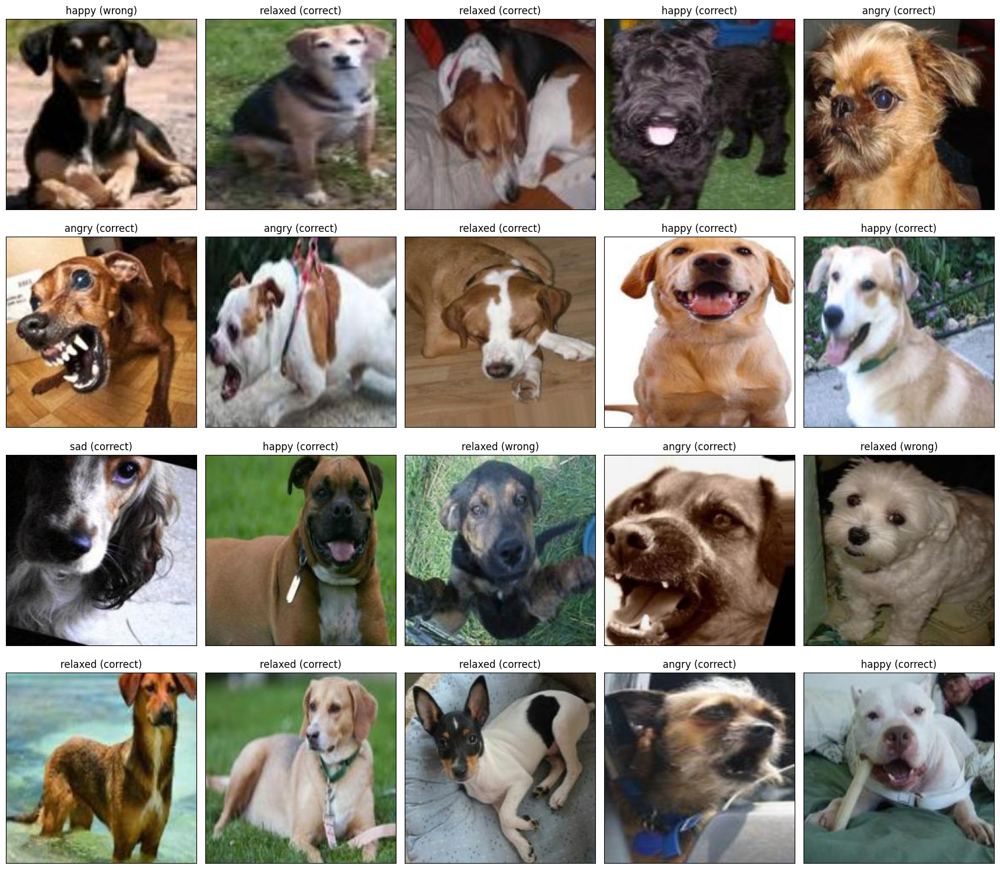

In [189]:
size = 224

num_samples = 20
random_indices = np.random.choice(len(X_test), size=num_samples, replace=False)

_, subplots = plt.subplots(nrows=4, ncols=5, figsize=(17, 15))

for i, idx in enumerate(random_indices):
    row = i // 5
    col = i % 5
    subplots[row, col].imshow(X_test[idx])
    subplots[row, col].set_xticks([])
    subplots[row, col].set_yticks([])
    subplots[row, col].set_title(
        str(predicted_labels_text[idx]) + (" (correct)" if predicted_labels[idx] == y_test[idx] else " (wrong)")
    )

plt.tight_layout()
plt.show()

## Conclusion <a class="anchor" id="conclusion-mobilenet-fine-tune"></a>

In conclusion, fine-tuning the `MobileNet` base during training has demonstrated the best performance among all models tested. This approach allowed the model to fine-tune its learned features more effectively, resulting in improved accuracy and generalization across various evaluation metrics. By selectively unfreezing layers, the model was able to adapt more closely to the specific characteristics of the dataset, ultimately improving its capability to identify and classify relevant patterns.

# References <a class="anchor" id="references"></a>

(1) Dog emotion. (2023, February 9). Kaggle. https://www.kaggle.com/datasets/danielshanbalico/dog-emotion

(2) Colino, S. (2021, October 1). Yes, dogs can "catch" their owners' emotions. Premium. https://www.nationalgeographic.com/premium/article/yes-dogs-can-catch-their-owners-emotions